# Library load 

In [12]:
import sys
sys.path.insert(0, '../scripts/')

import kaggle_credit_default_utilities as kg
import pandas as pd
import numpy as np
import lightgbm as lbm
import sklearn
import shap
shap.initjs()

https://www.kaggle.com/c/home-credit-default-risk/discussion/64821

# Generate DF

In [13]:
df = kg.create_dataset(debug=True)

Train samples: 10000, test samples: 10000
Bureau df shape: (2011, 108)
Process bureau and bureau_balance - done in 0s
Previous applications df shape: (9734, 242)
Process previous_applications - done in 1s
Pos-cash balance df shape: (9494, 15)
Process POS-CASH balance - done in 0s
Installments payments df shape: (8893, 26)
Process installments payments - done in 0s
Credit card balance df shape: (9520, 131)
Process credit card balance - done in 0s


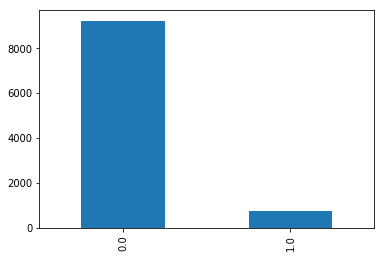

In [14]:
df['TARGET'].value_counts().plot(kind='bar')

In [15]:
df.head()

,index,AMT_ANNUITY,AMT_CREDIT,AMT_GOODS_PRICE,AMT_INCOME_TOTAL,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_WEEK,...,CC_NAME_CONTRACT_STATUS_Signed_MAX,CC_NAME_CONTRACT_STATUS_Signed_MEAN,CC_NAME_CONTRACT_STATUS_Signed_SUM,CC_NAME_CONTRACT_STATUS_Signed_VAR,CC_NAME_CONTRACT_STATUS_nan_MIN,CC_NAME_CONTRACT_STATUS_nan_MAX,CC_NAME_CONTRACT_STATUS_nan_MEAN,CC_NAME_CONTRACT_STATUS_nan_SUM,CC_NAME_CONTRACT_STATUS_nan_VAR,CC_COUNT
0,0,24700.5,406597.5,351000.0,202500.0,0.0,0.0,0.0,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,35698.5,1293502.5,1129500.0,270000.0,0.0,0.0,0.0,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2,6750.0,135000.0,135000.0,67500.0,0.0,0.0,0.0,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,3,29686.5,312682.5,297000.0,135000.0,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,4,21865.5,513000.0,513000.0,121500.0,0.0,0.0,0.0,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


# Train & stuff

In [16]:
%%time
feature_importance, datasets, model = kg.kfold_lightgbm(df, num_folds = 2, debug=True)

Starting LightGBM. Train shape: (10000, 768), test shape: (10000, 768)
Training until validation scores don't improve for 200 rounds.
[200]	training's binary_logloss: 0.216752	training's auc: 0.820866	valid_1's binary_logloss: 0.247009	valid_1's auc: 0.76618
[400]	training's binary_logloss: 0.200322	training's auc: 0.862861	valid_1's binary_logloss: 0.246434	valid_1's auc: 0.765351
Early stopping, best iteration is:
[291]	training's binary_logloss: 0.208321	training's auc: 0.842893	valid_1's binary_logloss: 0.246198	valid_1's auc: 0.766929
Fold  1 AUC : 0.766929
Training until validation scores don't improve for 200 rounds.
[200]	training's binary_logloss: 0.219284	training's auc: 0.845901	valid_1's binary_logloss: 0.239641	valid_1's auc: 0.727546
[400]	training's binary_logloss: 0.202317	training's auc: 0.878037	valid_1's binary_logloss: 0.240885	valid_1's auc: 0.728074
Early stopping, best iteration is:
[234]	training's binary_logloss: 0.215877	training's auc: 0.851734	valid_1's bina

# SHAP

### Margin explainer

## TO-DO

* Handle better the features
* Handle better the missing target
* Retrieve the train/val created

In [50]:
feats = [f for f in df.columns if f not in ['TARGET','SK_ID_CURR','SK_ID_BUREAU','SK_ID_PREV','index']]
sampled_df = sklearn.utils.resample(df[feats], n_samples=1000, replace=False)
explainer = shap.TreeExplainer(model)
shap_values = explainer.shap_values(sampled_df)
shap.force_plot(explainer.expected_value, shap_values[0,:],sampled_df.iloc[[0]])

Expected value starts low, that means the model starts with the assumption that there's very low risk

what the model predicts

In [51]:
model.predict(np.array(sampled_df.iloc[[0]]).reshape(1, -1))

array([0.])

model probabilities

In [52]:
model.predict_proba(np.array(sampled_df.iloc[[0]]).reshape(1, -1))

array([[0.84170144, 0.15829856]])

Sigmoid function #Should type this directly for extra points?

In [53]:
import math
def sigmoid(x):
    return 1/(1+math.exp(-x))

RAW output then sigmoid

In [55]:
sigmoid(-1.67)

0.15842417884495583

# Relative importance for a given prediction: The *log*

In [56]:
def get_relative_importance(explainer, names, obv):
    """
    Calculates the relative importance to the overall prediction. This is not translated into probability impact,
    but gives a better idea of the magnitude of a variable in the context of the others.
    
    The provided _explainer_ is applied to the provided observation (in _values_). Then the absolute shap values are 
    sumed and a percent is calculated from that total by feature (without the base value!)
    
    A dataframe is returned with the results
    
    Params:
       * explainer: SHAP explainer
       * names: column names of the features
       * values: column values of the observation
    """
    shap_values_obvs = explainer.shap_values(obv)
    interpretation = pd.DataFrame({"name":names,"value":shap_values_obvs[0]})
    interpretation['impact_from_base'] = interpretation['value'].abs()
    interpretation['impact_from_base'] = (interpretation['impact_from_base'] / interpretation['impact_from_base'].sum())
    return interpretation.sort_values(by=['impact_from_base'], ascending=False)

In [57]:
get_relative_importance(explainer, sampled_df.columns, sampled_df.iloc[[0]])

,name,value,impact_from_base
37,EXT_SOURCE_3,0.405281,0.195643
36,EXT_SOURCE_2,0.377732,0.182344
25,DAYS_LAST_PHONE_CHANGE,0.124002,0.059860
35,EXT_SOURCE_1,0.118958,0.057425
23,DAYS_EMPLOYED,-0.109103,0.052668
22,DAYS_BIRTH,-0.105798,0.051072
119,NAME_EDUCATION_TYPE_Higher education,0.078055,0.037680
90,OBS_30_CNT_SOCIAL_CIRCLE,0.072987,0.035233
242,PAYMENT_RATE,-0.061815,0.029840
2,AMT_GOODS_PRICE,0.047238,0.022804


Your actual predict call could look a bit like this

In [58]:
def predict_value(model, explainer, names, values):
    prediction = model.predict(np.array(values).reshape(1, -1))
    explanation = get_relative_importance(explainer, names, values)
    return {'prediction':prediction, 'explanation':explanation.to_dict(orient='records')}

In [59]:
predict_value(model, explainer,sampled_df.columns, sampled_df.iloc[[0]])

{'prediction': array([0.]),
 'explanation': [{'name': 'EXT_SOURCE_3',
   'value': 0.40528139988994905,
   'impact_from_base': 0.19564303235817554},
  {'name': 'EXT_SOURCE_2',
   'value': 0.37773237959251904,
   'impact_from_base': 0.18234418895961424},
  {'name': 'DAYS_LAST_PHONE_CHANGE',
   'value': 0.12400157779581256,
   'impact_from_base': 0.05985975350400635},
  {'name': 'EXT_SOURCE_1',
   'value': 0.11895804295713477,
   'impact_from_base': 0.05742506873951688},
  {'name': 'DAYS_EMPLOYED',
   'value': -0.10910298762229045,
   'impact_from_base': 0.05266770037696654},
  {'name': 'DAYS_BIRTH',
   'value': -0.10579764577263039,
   'impact_from_base': 0.05107210012829124},
  {'name': 'NAME_EDUCATION_TYPE_Higher education',
   'value': 0.07805516481585857,
   'impact_from_base': 0.03767986672948339},
  {'name': 'OBS_30_CNT_SOCIAL_CIRCLE',
   'value': 0.07298713393058238,
   'impact_from_base': 0.035233356895206354},
  {'name': 'PAYMENT_RATE',
   'value': -0.061814736629692044,
   'imp

Or send that second part to *logging.debug(explanation)* for example, in a different call if reponse time is critical

## Alterative: Explain probs

Keep in mind is an alternative method and won't match 1-1

In [60]:
explainer = shap.TreeExplainer(model, sampled_df, model_output='probability',feature_dependence='independent')
shap_values = explainer.shap_values(sampled_df)

100%|===================| 997/1000 [00:46<00:00]        

In [61]:
shap.force_plot(explainer.expected_value, shap_values[0,:], sampled_df.iloc[[0]])

In [62]:
explainer.expected_value

0.08657466849504064

In [74]:
tmpdf = pd.DataFrame({"name":sampled_df.columns,"probs":explainer.shap_values(sampled_df.iloc[[0]])[0]})
tmpdf['abs_probs'] = tmpdf['probs'].abs() * 100
tmpdf.sort_values(by=['abs_probs'], ascending=False)

,name,probs,abs_probs
36,EXT_SOURCE_2,0.030565,3.056542
37,EXT_SOURCE_3,0.018118,1.811820
23,DAYS_EMPLOYED,-0.012702,1.270231
22,DAYS_BIRTH,-0.012074,1.207388
25,DAYS_LAST_PHONE_CHANGE,0.010969,1.096930
35,EXT_SOURCE_1,0.009653,0.965313
242,PAYMENT_RATE,-0.007055,0.705511
119,NAME_EDUCATION_TYPE_Higher education,0.006889,0.688870
90,OBS_30_CNT_SOCIAL_CIRCLE,0.006702,0.670247
238,DAYS_EMPLOYED_PERC,-0.004578,0.457766


# Back to margins mode

In [75]:
explainer = shap.TreeExplainer(model)
shap_values = explainer.shap_values(sampled_df)

# Feature importance

Original VS shap

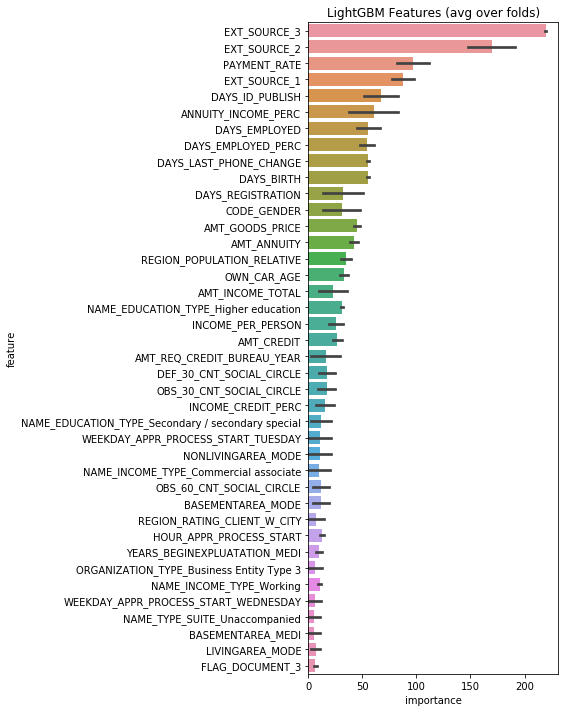

In [76]:
kg.display_importances(feature_importance)

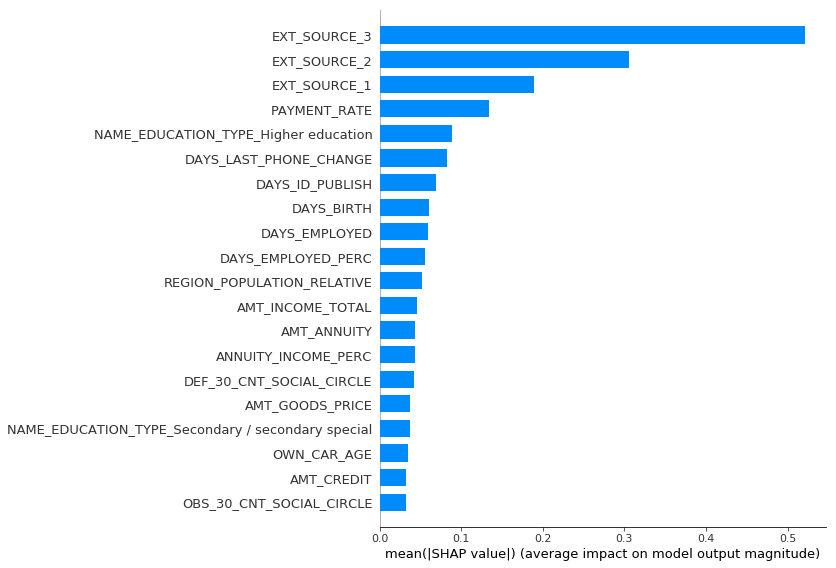

In [34]:
shap.summary_plot(shap_values, sampled_df, plot_type="bar")

In this case, the variables with the biggest impact are (what appears to be) external sources... ? Is that a good sign?

# Dependence Plot

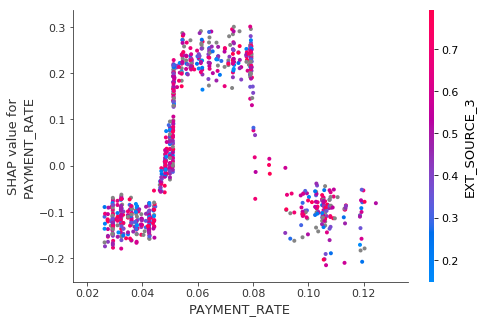

In [78]:
shap.dependence_plot("PAYMENT_RATE", shap_values, sampled_df)

Payment_rate indicates that how it impacts the model varies a lot.

<0.05 is a sighly-to-none negative impact, the same with >0.09

Between that interval, the impact is positive, and overall, independet of ext_source_3

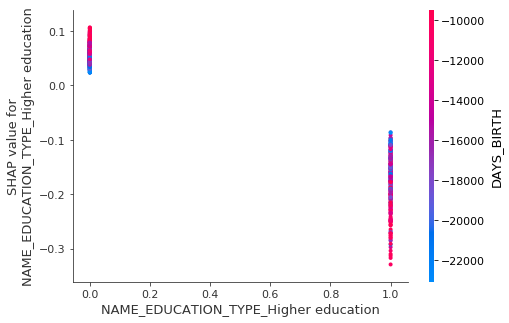

In [79]:
# create a SHAP dependence plot to show the effect of a single feature across the whole dataset
shap.dependence_plot("NAME_EDUCATION_TYPE_Higher education", shap_values, sampled_df)

HUUUUMMMMMMmmmmmmm...... education, huh...

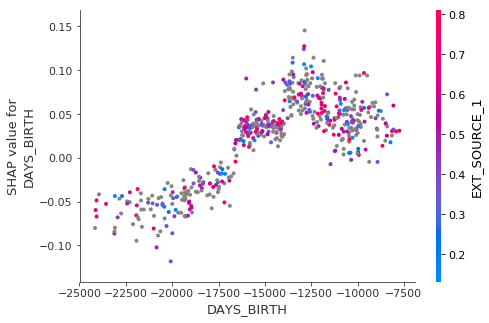

In [80]:
# create a SHAP dependence plot to show the effect of a single feature across the whole dataset
shap.dependence_plot("DAYS_BIRTH", shap_values, sampled_df)

The older you are, the less propension to default.

Between X-Y, almost nothing

Younger than X is about how much does impact your propension to default

# Trainingset breakdown


This is basically applying shap to the whole datset, mind that.

In [24]:
# visualize the training set predictions
#sampled_df = sklearn.utils.resample(df[feats], n_samples=1000, replace=False)
#shap_values = explainer.shap_values(sampled_df)
shap.force_plot(explainer.expected_value, shap_values, sampled_df)

# Overall feature effect

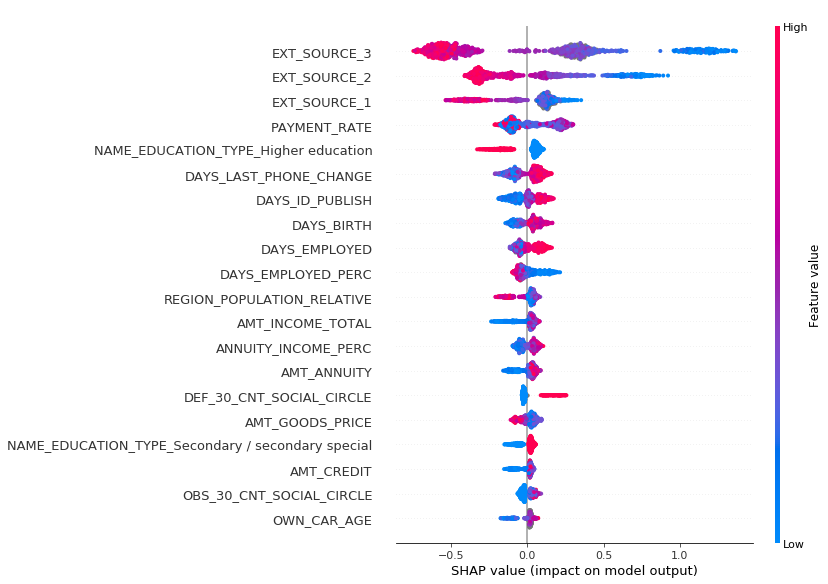

In [81]:
# summarize the effects of all the features
shap.summary_plot(shap_values, sampled_df)

###  read: https://blog.dominodatalab.com/shap-lime-python-libraries-part-2-using-shap-lime/